In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from models.autoencoder import DenseAutoencoder
from models.flows import MAF
from models.nn import PaeBuilder

import tensorflow as tf
import tensorflow_probability as tfp
import tensorflow.keras as tfk
print(tf.__version__)

2.3.1


In [2]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
#tf.config.list_physical_devices()


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 3773635089622807511
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 2413084462096268421
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 15966240318807829875
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 5155440576
locality {
  bus_id: 1
  links {
  }
}
incarnation: 1305182350711302390
physical_device_desc: "device: 0, name: GeForce GTX 1060, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


In [3]:
from loaders.LHCO import LhcoRnDLoader
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer

scaler = QuantileTransformer(output_distribution='uniform')
#scaler = MinMaxScaler()
files = {
    'bkg':'../data/RnD_bkg_HLF.h5',
    'sig1':'../data/RnD_sig1_HLF.h5',
    'sig2':'../data/RnD_sig2_HLF.h5'
}

train_fractions = {
    'bkg':1
}

test_fractions = {
    'bkg':.5,
    'sig1':.5
}

loader = LhcoRnDLoader(files, 'all', scaler)
loader.preprocessing('bkg')
train = loader.make_train_val(250_000, train_fractions, val_split=.2)
test = loader.make_test(100_000, test_fractions, replace=False)

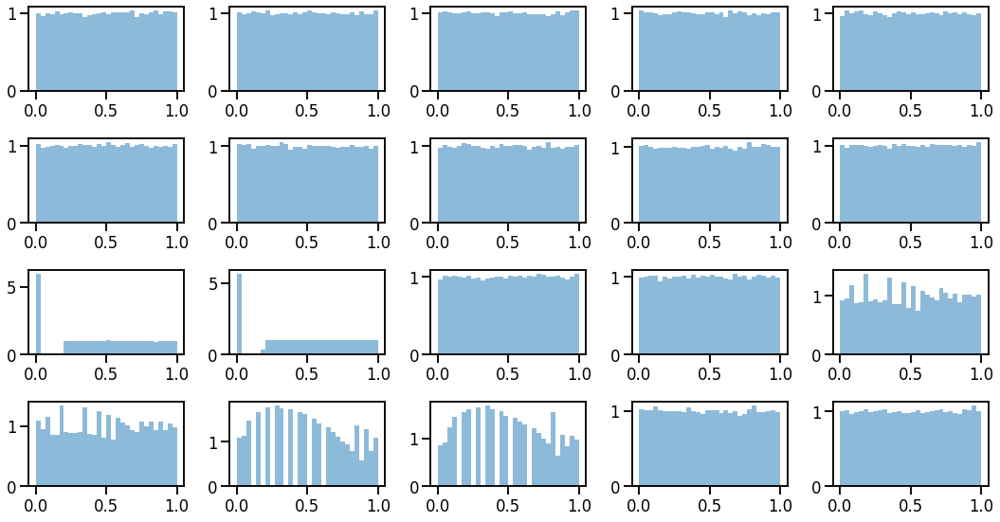

In [4]:
from utils.plotting import feature_plots

feature_plots(train['x_train'])



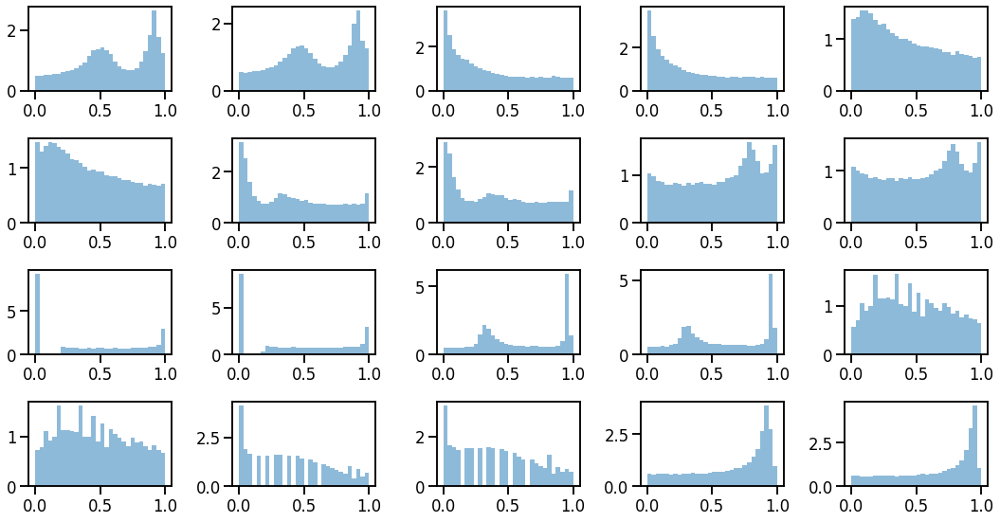

In [5]:
feature_plots(test['x_test'])


### Reweighting

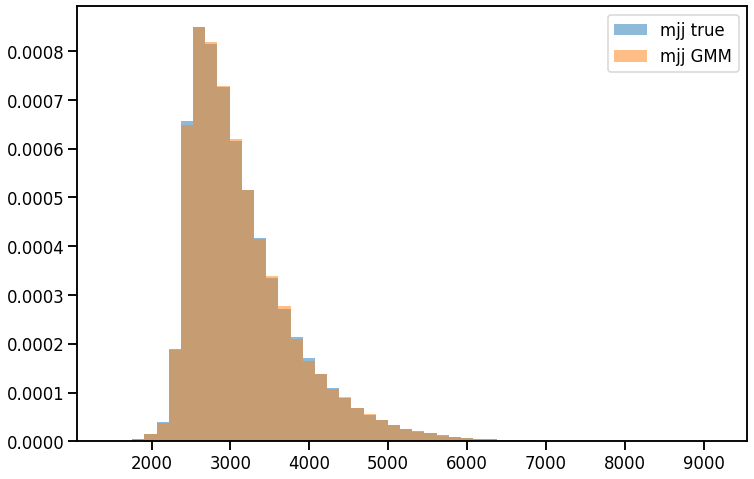

In [6]:
from sklearn.mixture import GaussianMixture
GMM = GaussianMixture

gmm = GMM(n_components=200, covariance_type='full').fit(train["excl_train"])
plt.figure(figsize=(12,8))
_, b, _ = plt.hist(train["excl_train"], bins=50, label='mjj true', alpha=.5, density=True)
sample = gmm.sample(train["excl_train"].shape[0])
plt.hist(sample[0], bins=b, label='mjj GMM', alpha=.5, density=True)
plt.legend()
plt.show()

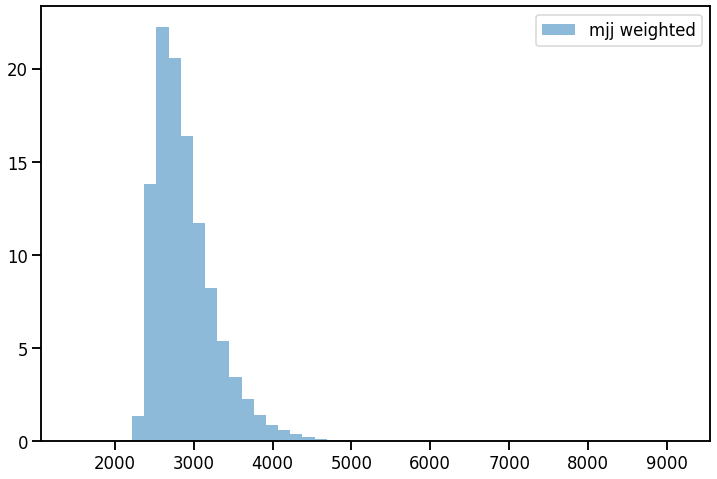

In [7]:
weights2 = gmm.score_samples(train["excl_train"])
weights2_valid = gmm.score_samples(train["excl_valid"])
plt.figure(figsize=(12,8))
_, b, _ = plt.hist(train["excl_train"], bins=50, label='mjj weighted', alpha=.5, weights=np.exp(weights2))
plt.legend()
plt.show()

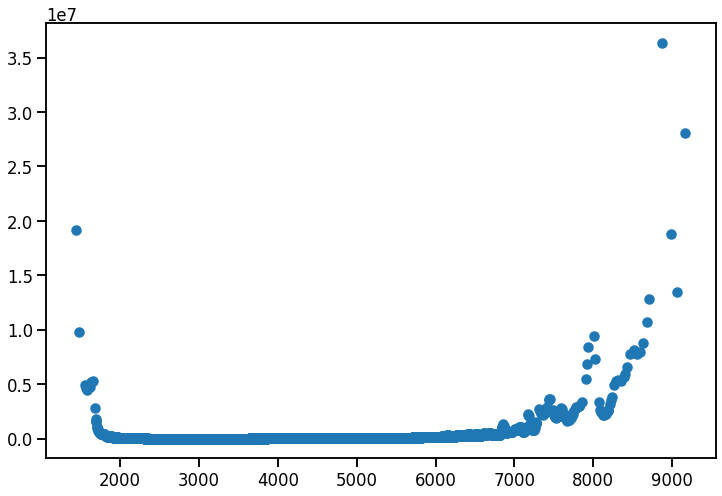

In [8]:
plt.figure(figsize=(12,8))
plt.scatter(train["excl_train"][:,0], 1/np.exp(weights2))
plt.show()

In [9]:
import tensorflow as tf
import tensorflow_probability as tfp
import tensorflow.keras as tfk
import numpy as np
import sys

tfd = tfp.distributions
tfb = tfp.bijectors
tfkl = tfk.layers

sys.path.append('../')

from models.autoencoder import DenseAutoencoder
from models.flows import MAF

In [10]:

builder = PaeBuilder()

ae_config = {
    'input_dim':47, 
    'encoding_dim':10, 
    'units_list':[30],
    'weight_reg':tfk.regularizers.l1(1e-6),
    'output_activation':tf.nn.sigmoid
}
nf_config = {
    'n_dims':10, 
    'n_layers':5, 
    'units':[32 for i in range(4)]
}
optimizer_ae = {
    'lr': 0.05
}
optimizer_nf = {
    'lr': 0.005
}

builder.make_ae_model(DenseAutoencoder, ae_config)
builder.make_nf_optimizer(tfk.optimizers.Adam, optimizer_ae)
builder.make_nf_model(MAF, nf_config)
builder.make_nf_optimizer(tfk.optimizers.Adam, optimizer_nf)
builder.compile_ae()
builder.compile_nf()
pae = builder.pae

In [11]:
ae_train ={
    'batch_size':200,
    'epochs':180,
    'sample_weight':1/np.exp(weights2),
    'validation_data':(train["x_valid"],train["x_valid"],1/np.exp(weights2_valid)),
    'callbacks':tfk.callbacks.ReduceLROnPlateau(
        factor=0.2,
        patience=10,
        verbose=1
    )
}

nf_train ={
    'batch_size':200,
    'epochs':100,
    'validation_data':(train["x_valid"],train["x_valid"]),
    'callbacks':tfk.callbacks.ReduceLROnPlateau(
        factor=0.2,
        patience=5,
        verbose=1
    )
}
with tf.device("/device:CPU:0"):
    %time pae.fit(train["x_train"],ae_train,nf_train)


Epoch 00100: ReduceLROnPlateau reducing learning rate to 0.00020000000949949026.
1000/1000 [==============================] - 1s 1ms/step - loss: 69.8868 - val_loss: 71.7905
Epoch 101/180
1000/1000 [==============================] - 1s 1ms/step - loss: 64.4535 - val_loss: 66.7653
Epoch 102/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.7535 - val_loss: 69.9289
Epoch 103/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.7577 - val_loss: 66.4749
Epoch 104/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.7736 - val_loss: 67.2278
Epoch 105/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.7772 - val_loss: 66.2656
Epoch 106/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.6279 - val_loss: 66.1715
Epoch 107/180
1000/1000 [==============================] - 1s 1ms/step - loss: 63.7054 - val_loss: 66.2589
Epoch 108/180
1000/1000 [==============================] - 1s 1ms/step - los

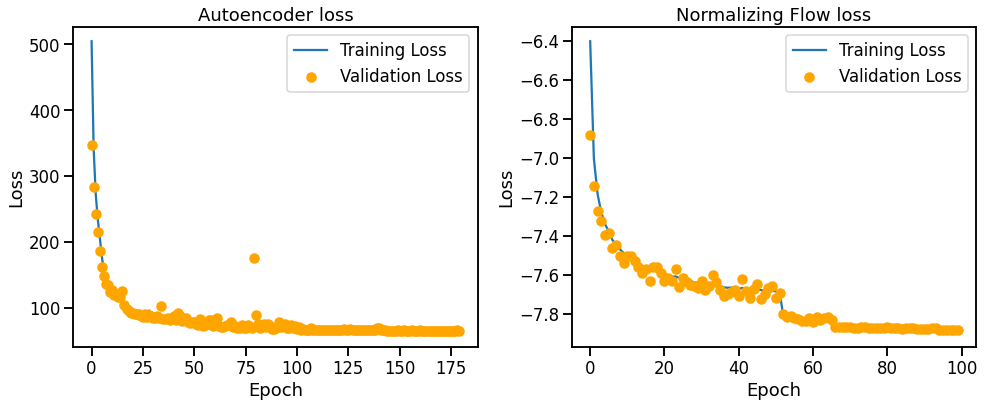

In [12]:
from utils.plotting import loss_plot, latent_space_plot, mjj_cut_plot, \
                           sculpting_plot, roc_plot

loss_plot(pae.history)


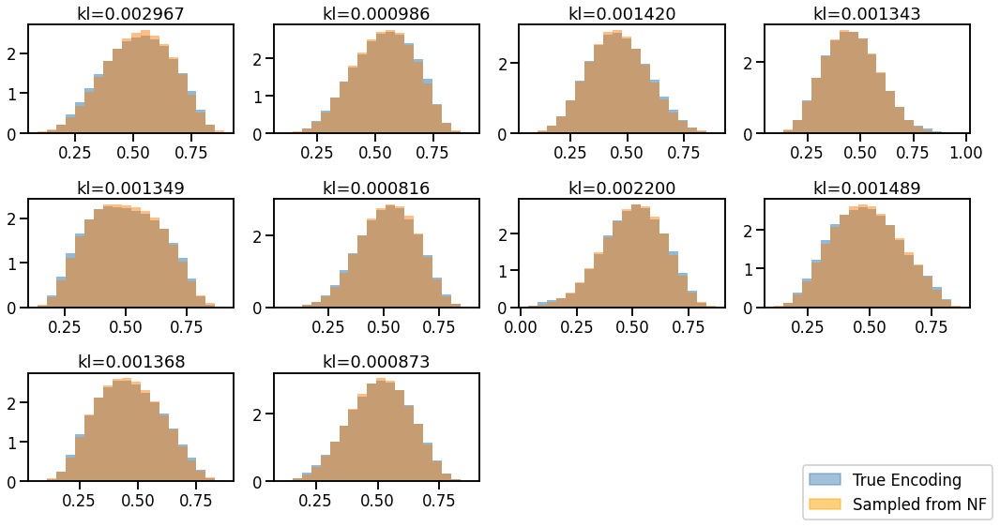

In [13]:
z_true = pae.ae.encode(train['x_train'])
z_sample = pae.nf.sample(train['x_train'].shape[0])

latent_space_plot(z_true, z_sample, save_path='plots/latent_space.png')

In [14]:
def optimal_grid(n):
    rows = np.floor(np.sqrt(n))
    residual = 1 if n%rows != 0 else 0
    cols = n//rows + residual
    return int(rows), int(cols)



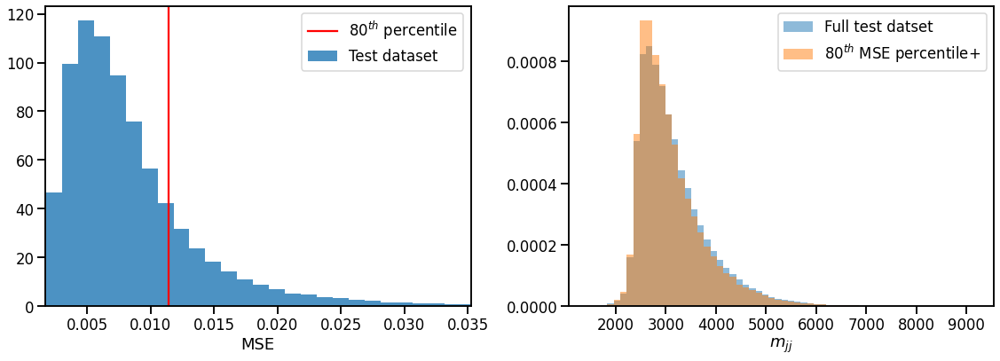

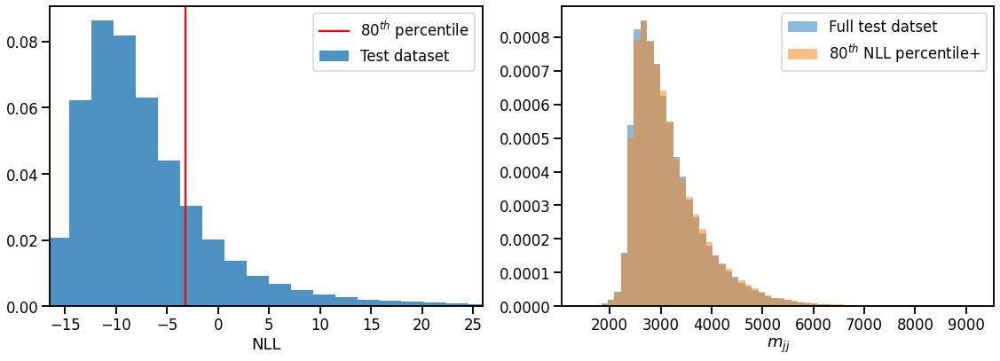

(array([2840.05212268, 3150.08523211, 4411.63705058, ..., 3000.46538118,
        2779.04329701, 2889.28345372]),
 array([2932.3973875 , 3019.04196831, 2573.98936109, ..., 3516.42718328,
        3004.94306816, 2889.28345372]))

In [15]:
mse = pae.reco_error(train['x_train'])
pae.compute_implicit_sigma(train['x_valid'])
ascore = -pae.anomaly_score(train['x_train'])

mjj_cut_plot(mse, train['excl_train'], prc=80, score_name='MSE')#, save_path='./plots/mse_cut.png')
mjj_cut_plot(ascore, train['excl_train'], prc=80, score_name='NLL')


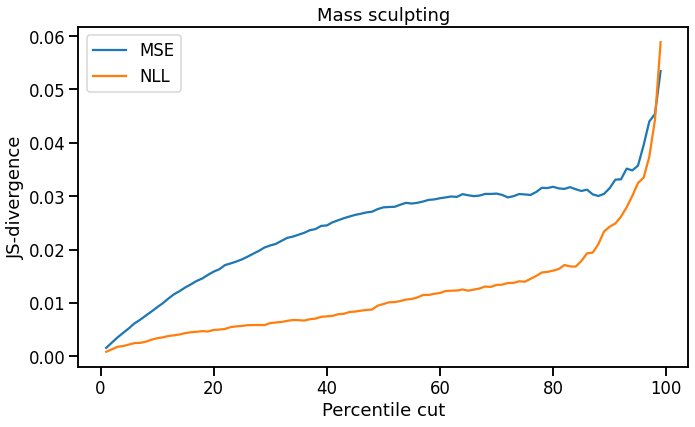

In [16]:
ano_scores = {
    'MSE': mse,
    'NLL': ascore
}

sculpting_plot(ano_scores, train['excl_train'], max_prc=99, save_path='./plots/mass_sculpting.png')

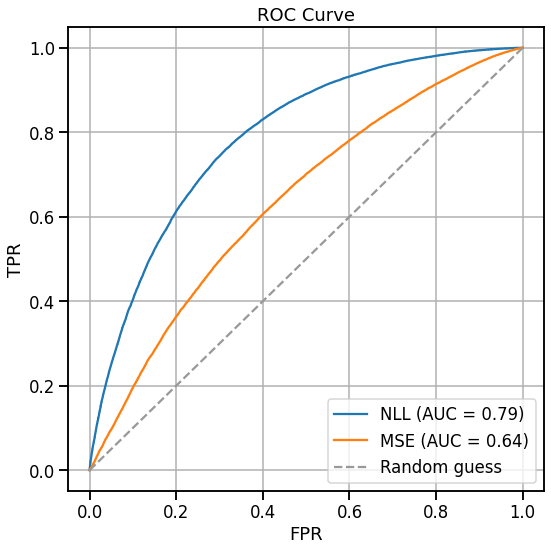

In [17]:
def binarize(label):
    return 1 if label == 'sig1' else 0

mse_test = pae.reco_error(test['x_test'])
ascore_test = -pae.anomaly_score(test['x_test'])
targets = np.array(list(map(binarize, test['labels'])))

scores = {
    'NLL':ascore_test,
    'MSE':mse_test
}
roc_plot(targets,scores,save_path='./plots/roc_50prc.png')

In [18]:
def mjj_cut_plot(ano_score, mjj, 
                 prc: int = 75, 
                 bins: int = 60, 
                 x_min_prc: float = 0.5,
                 x_max_prc: float = 99.5,
                 score_name: str = 'anomaly score', 
                 save_path: str = None):
    
    x_min = np.percentile(ano_score, x_min_prc)
    x_max = np.percentile(ano_score, x_max_prc)
    x_prc = np.percentile(ano_score, prc)
    i_prc = np.where(ano_score >= x_prc)[0]

    plt.figure(figsize=(16,6))
    plt.subplot(1,2,1)
    plt.hist(ano_score, bins=bins, density=True, alpha=.8, 
             label='Test dataset')
    plt.xlim(x_min,x_max)
    plt.axvline(x_prc, color='red', label=f'{prc}''$^{th}$ percentile')
    plt.legend()
    plt.xlabel(f'{score_name}')

    plt.subplot(1,2,2)
    n_bkg, b, _ = plt.hist(mjj, bins=bins, density=True, alpha=.5, 
                       label='Full test datset')
    n_sig, _, _ = plt.hist(mjj[i_prc], bins=b, density=True, alpha=.5, 
                       label=f'{prc}''$^{th}$'f' {score_name} percentile+')
    plt.xlabel('$m_{jj}$')
    plt.legend()
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path)
    plt.show()
    return mjj.ravel(), mjj[i_prc].ravel()

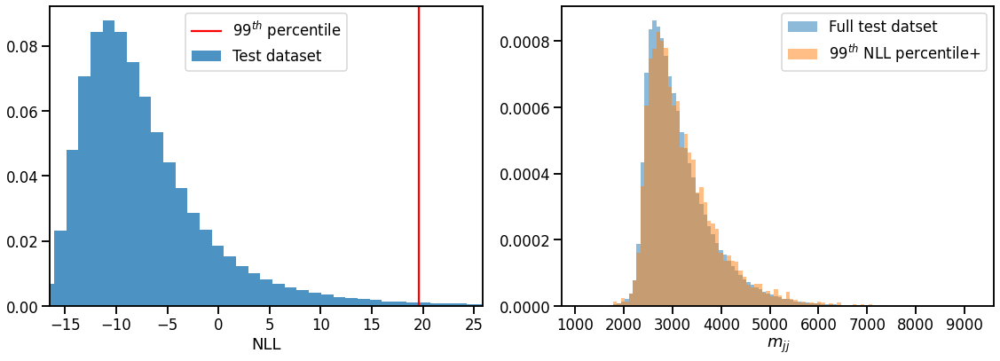

In [19]:
test_fractions = {
    'bkg':.9999,
    'sig1':.0001
}
test2 = loader.make_test(500_000, test_fractions, replace=False)

ascore_test = -pae.anomaly_score(test2['x_test'])
bkg, data = mjj_cut_plot(ascore_test, test2['excl_test'], prc=99, score_name='NLL', bins=100, save_path='./plots/cut_01prc.png')


In [20]:
bkg.shape[0]/data.shape[0]
weights = np.repeat(1/(bkg.shape[0]/data.shape[0]),bkg.shape[0])

In [21]:
import pyBumpHunter as BH

hunter = BH.BumpHunter(rang=(3000,4500),
                       width_min=2,
                       width_max=6,
                       width_step=1,
                       scan_step=1,
                       Npe=10000,
                       Nworker=1,
                       seed=666,
                       weights=weights
                    )

# x_prc_50 = np.percentile(ascore_test, 50)

# high_prc = np.where(ascore_test >= x_prc_50)
# low_prc = np.where(ascore_test <= x_prc_50)

# data, bkg = test2['excl_test'][high_prc][:,0], test2['excl_test'][low_prc][:,0]

%time hunter.BumpScan(data,bkg)

Generating histograms
5 values of width will be tested
SCAN
Global p-value : 0.5600  (5600 / 10000)
Significance = -0.15097

CPU times: user 12.8 s, sys: 0 ns, total: 12.8 s
Wall time: 12.8 s


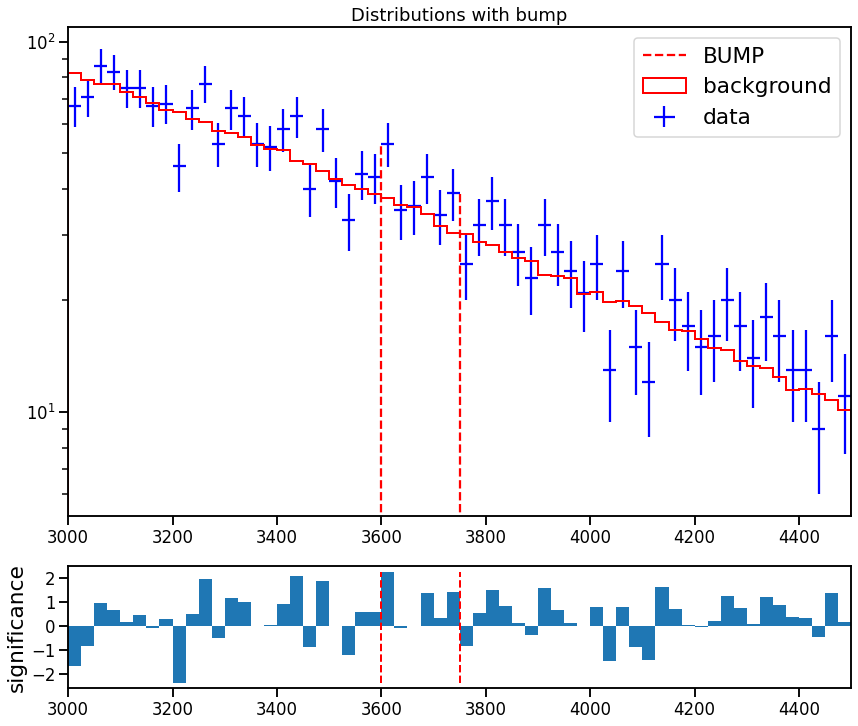

In [23]:
hunter.PlotBump(data,bkg)#, filename='./plots/bump_01prc.png')


In [ ]:
hunter.PrintBumpTrue(data,bkg)

In [ ]:
targets = np.array(list(map(binarize, test2['labels'])))

scores = {
    'NLL':ascore_test
}
roc_plot(targets,scores,save_path='./plots/roc_1prc.png')